# Result analysis

## Setup

In [99]:
import pandas as pd
import numpy as np
import json
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

In [ ]:
results_df = pd.read_csv("output/content_style_iou_results.csv")
with open('entities/artists_movements.json') as f:
    artists_movements = json.load(f)
with open('entities/objects_categories.json') as f:
    objects_categories = json.load(f)

In [101]:
with open("./entities/artists.txt") as f:
    artists = [artist.split()[1].replace("_", " ") for artist in f.read().splitlines()]
with open("./entities/movements.txt") as f:
    movements = [style.split()[1].replace("_", " ") for style in f.read().splitlines()]

In [102]:
ONTOLOGY = {
    'bicycle': 'non modern vehicle',
    'boat': 'non modern vehicle',
    'train': 'non modern vehicle',
    
    'bus': 'modern vehicle',
    'truck': 'modern vehicle',
    'car': 'modern vehicle',
    'motorcycle': 'modern vehicle',
    'airplane': 'modern vehicle',
    
    'traffic light': 'road items',
    'fire hydrant': 'road items',
    'stop sign': 'road items',
    'parking meter': 'road items',
    
    'bench': 'furniture',
    'chair': 'furniture',
    'couch': 'furniture',
    'potted plant': 'furniture',
    'bed': 'furniture',
    'dining table': 'furniture',
    'toilet': 'furniture',
    'sink': 'furniture',
    
    'backpack': 'wearables',
    'umbrella': 'wearables',
    'handbag': 'wearables',
    'tie': 'wearables',
    'suitcase': 'wearables',
    
    'snowboard': 'sports equipment',
    'surfboard': 'sports equipment',
    'skateboard': 'sports equipment',
    'frisbee': 'sports equipment',
    'skis': 'sports equipment',
    'sports ball': 'sports equipment',
    'kite': 'sports equipment',
    'baseball bat': 'sports equipment',
    'baseball glove': 'sports equipment',
    'tennis racket': 'sports equipment',
    
    'cat': 'common animals',
    'dog': 'common animals',
    'bird': 'common animals',
    'cow': 'common animals',
    'horse': 'common animals',
    'sheep': 'common animals',
    'mouse': 'common animals',
    
    'elephant': 'wild animals',
    'bear': 'wild animals',
    'zebra': 'wild animals',
    'giraffe': 'wild animals',
    
    'fork': 'kitchen utensils',
    'knife': 'kitchen utensils',
    'spoon': 'kitchen utensils',
    'bottle': 'kitchen utensils',
    'cup': 'kitchen utensils',
    'bowl': 'kitchen utensils',
    'wine glass': 'kitchen utensils',
    
    'banana': 'fruits',
    'apple': 'fruits',
    'orange': 'fruits',
    
    'broccoli': 'vegetables',
    'carrot': 'vegetables',
    
    'sandwich': 'meals',
    'hot dog': 'meals',
    'pizza': 'meals',
    
    'cake': 'desserts',
    'donut': 'desserts',
    
    'tv': 'electronics',
    'cell phone': 'electronics',
    'laptop': 'electronics',
    'oven': 'electronics',
    'toaster': 'electronics',
    'refrigerator': 'electronics',
    'remote': 'electronics',
    'keyboard': 'electronics',
    'microwave': 'electronics',
    'hair drier': 'electronics',
    
    'book': 'common objects',
    'clock': 'common objects',
    'vase': 'common objects',
    'scissors': 'common objects',
    'teddy bear': 'common objects',
    'toothbrush': 'common objects',
    
    'person': 'person'
}

In [103]:
results_df["liz_content_category"] = results_df["content_word"].apply(lambda x: ONTOLOGY[x])

In [104]:
results_df["template"] = results_df.apply(
    lambda row: row["prompt"]
        .replace(str(row["content_word"]), "<CONTENT>")
        .replace(str(row["style_word"]), "<STYLE>"),
    axis=1
)

In [105]:
artists_styles = [style for styles in artists_movements.values() for style in styles]
style_cols = []
for style in set(results_df["style_word"].unique().tolist() + artists_styles):
    if style in artists_movements:
        continue
    results_df[style] = results_df["style_word"].apply(lambda x: x == style or style in artists_movements.get(x, []))
    style_cols.append(style)

results_df["content_category"] = results_df["content_word"].apply(lambda x: objects_categories.get(x, x))

In [9]:
results_df.head(2)

,prompt,template,content_word,style_word,seed,use_quantile,iou_threshold,iou_baseline_mean,iou_baseline_std,support_a_baseline,...,Action painting,Northern Renaissance,Minimalism,Mannerism Late Renaissance,Pop Art,Cubism,Fauvism,Post Impressionism,Abstract Expressionism,content_category
0,a painting of a person in the Abstract Express...,a painting of a <CONTENT> in the <STYLE> style,person,Abstract Expressionism,0,False,0.1,0.934055,0.055966,0.936863,...,False,False,False,False,False,False,False,False,True,person
1,a painting of a person in the Abstract Express...,a painting of a <CONTENT> in the <STYLE> style,person,Abstract Expressionism,0,True,0.1,0.847405,0.038919,0.900000,...,False,False,False,False,False,False,False,False,True,person


Some values are NaN because the prompt does not contain other tokens than the content and style tokens

In [10]:
results_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288000 entries, 0 to 287999
Data columns (total 54 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   prompt                            288000 non-null  object 
 1   template                          288000 non-null  object 
 2   content_word                      288000 non-null  object 
 3   style_word                        288000 non-null  object 
 4   seed                              288000 non-null  int64  
 5   use_quantile                      288000 non-null  bool   
 6   iou_threshold                     288000 non-null  float64
 7   iou_baseline_mean                 288000 non-null  float64
 8   iou_baseline_std                  288000 non-null  float64
 9   support_a_baseline                288000 non-null  float64
 10  support_b_baseline                288000 non-null  float64
 11  support_intersection_baseline     288000 non-null  f

## Metrics

In [106]:
results_df["delta"] = results_df["iou_baseline_mean"] - results_df["iou_score"]
results_df["delta_cs"] = results_df["iou_baseline_cs_mean"] - results_df["iou_score"]
results_df["baseline_support_token"] = (results_df["support_a_baseline"]+ results_df["support_b_baseline"])/2
results_df["baseline_cs_support_token"] = (results_df["support_a_baseline_cs"]+ results_df["support_b_baseline_cs"])/2
results_df["support_content_style"] = (results_df["support_content"]+ results_df["support_style"])/2
results_df["threshold"] = results_df.apply(
    lambda row: f"{'P' if row['use_quantile'] else 'F'} {row['iou_threshold']}", axis=1
)

The computed metrics are expected to behave as follows:
- We expect the ``delta`` (difference between IoU scores) to be larger when the content and style heatmaps do not significantly intersect.
- ``iou_baseline_mean`` serves as a proxy for how much heatmap space, on average, each pair of words in the sentence shares.
- ``support_`` measures capture the relative number of pixels included in the heatmaps for:
- the first word (a or "content"),
- the second word (b or "style"),
- their union, and
- their intersection.

These metrics help us understand how many pixels are activated given a certain threshold. If support values drop too low, it’s more likely that the two heatmaps will share less salient space. While we do expect support to decrease with higher threshold values, it shouldn’t be excessively low. A reasonable estimate for expected support could be approximately $1 - t$, where $t$ is the threshold.

- We expect similar support values for both the baseline IoU and the content-style IoU scores, and ideally, they should be close to $1 - t$.
- Unlike the standard baseline, the content-style baseline (``iou_baseline_cs_mean``) considers only word pairs involving either the content or style word. This value should still be higher than the actual ``iou_score`` and indicates how much, on average, the content/style words overlap with other words in the prompt.
This measure is especially relevant for our case, as it focuses on the "important" words. If content and style words have little overlap with other words, it is more understandable that they might not overlap much with each other. This means that, if ``iou_baseline_cs_mean`` is close to ``iou_score``, we cannot confidently claim that the model is treating content and style as oppositional concepts.

In [107]:
group_cols = ["threshold"]

In [13]:
results_df.groupby(group_cols)["iou_score"].describe()

,count,mean,std,min,25%,50%,75%,max
threshold,,,,,,,,
F 0.1,16000.0,0.919218,0.087533,0.242798,0.893632,0.948869,0.977237,0.999928
F 0.2,16000.0,0.691505,0.195436,0.046240,0.563726,0.727169,0.849034,0.999125
F 0.3,16000.0,0.424590,0.230060,0.000000,0.237767,0.404267,0.598197,0.994773
F 0.4,16000.0,0.205613,0.204215,0.000000,0.045520,0.133962,0.304957,0.987177
F 0.5,16000.0,0.083200,0.148957,0.000000,0.000321,0.013053,0.094936,0.962930
F 0.6,16000.0,0.034713,0.098668,0.000000,0.000000,0.000000,0.010235,0.944964
F 0.7,16000.0,0.015444,0.063074,0.000000,0.000000,0.000000,0.000000,0.866475
F 0.8,16000.0,0.007371,0.042753,0.000000,0.000000,0.000000,0.000000,0.805972
F 0.9,16000.0,0.003740,0.033245,0.000000,0.000000,0.000000,0.000000,0.769328


In [14]:
fig = go.Figure()

fig.add_trace(
    go.Box(
        y=results_df["iou_score"],
        x=results_df["threshold"],
        boxmean=True
    )
)

fig.update_layout(
    title="IoU Scores by Threshold",
    xaxis_title="Threshold Configuration",
    yaxis_title="IoU Score",
)

fig.show()

Some of these are skewed distribution, it might be better to consider the median.

Median ``delta`` and ``delta_cs`` values for each threshold configuration.

In [15]:
results_df.groupby(group_cols).agg(
    delta_cs_med = ("delta_cs", np.median),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
    supp_content_style_med = ("support_content_style", np.median),
).round(3)

/tmp/ipykernel_1581673/812435020.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/812435020.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_cs_med,base_cs_supp_med,supp_content_style_med
threshold,,,
F 0.1,0.015,0.979,0.974
F 0.2,0.090,0.888,0.861
F 0.3,0.201,0.753,0.691
F 0.4,0.273,0.619,0.541
F 0.5,0.241,0.472,0.438
F 0.6,0.159,0.320,0.299
F 0.7,0.086,0.176,0.159
F 0.8,0.035,0.064,0.055
F 0.9,0.006,0.010,0.009


/tmp/ipykernel_1581673/499898105.py:2: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/499898105.py:2: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



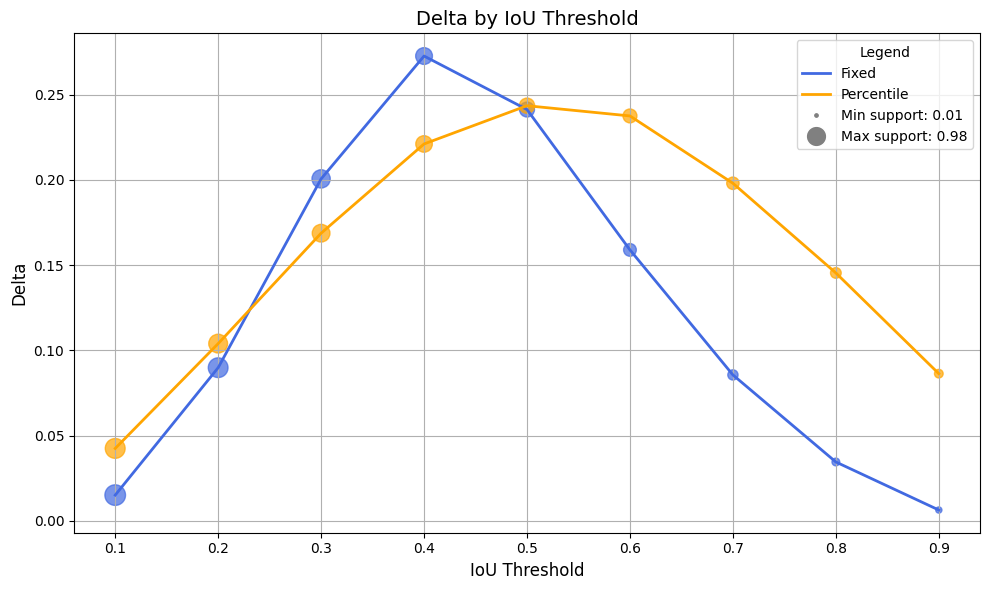

In [16]:
# --- Your data prep ---
plot_df = results_df.groupby(group_cols).agg(
    delta_med=("delta", np.median),
    delta_cs_med=("delta_cs", np.median),
    base_supp_med=("baseline_support_token", np.median),
    base_cs_supp_med=("baseline_cs_support_token", np.median),
    supp_content_style_med=("support_content_style", np.median),
    iou_threshold=("iou_threshold", np.median),
    use_quantile=("use_quantile", np.median)
).reset_index()

# --- Set up plot ---
fig, ax = plt.subplots(figsize=(10, 6))

colors = {0: "royalblue", 1: "orange"}
labels = {0: "Fixed", 1: "Percentile"}

# Normalize marker sizes
min_supp = plot_df["base_cs_supp_med"].min()
max_supp = plot_df["base_cs_supp_med"].max()
plot_df["marker_sizes"] = 200 * (plot_df["base_cs_supp_med"] - min_supp) / (max_supp - min_supp + 1e-8) + 20

# --- Plot each quantile group ---
for quantile_val in plot_df["use_quantile"].unique():
    filtered = plot_df[plot_df["use_quantile"] == quantile_val]

    ax.plot(
        filtered["iou_threshold"],
        filtered["delta_cs_med"],
        label=labels[quantile_val],
        color=colors[quantile_val],
        linewidth=2
    )
    ax.scatter(
        filtered["iou_threshold"],
        filtered["delta_cs_med"],
        s=filtered["marker_sizes"],
        color=colors[quantile_val],
        alpha=0.7
    )

# --- Create custom legend entries for marker sizes ---
legend_elements = [
    Line2D([0], [0], color='royalblue', lw=2, label='Fixed'),
    Line2D([0], [0], color='orange', lw=2, label='Percentile'),
    Line2D([0], [0], marker='o', color='w', label=f'Min support: {round(min_supp,2)}',
           markerfacecolor='gray', markersize=np.sqrt(plot_df["marker_sizes"].min())),
    Line2D([0], [0], marker='o', color='w', label=f'Max support: {round(max_supp,2)}',
           markerfacecolor='gray', markersize=np.sqrt(plot_df["marker_sizes"].max())),
]

ax.legend(handles=legend_elements, title="Legend")

# --- Axis labels and title ---
ax.set_title("Delta by IoU Threshold", fontsize=14)
ax.set_xlabel("IoU Threshold", fontsize=12)
ax.set_ylabel("Delta", fontsize=12)
ax.grid(True)

plt.tight_layout()
plt.show()

/tmp/ipykernel_1581673/1836806123.py:2: FutureWarning:

The provided callable <function mean at 0x775bd01d2d40> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

/tmp/ipykernel_1581673/1836806123.py:2: FutureWarning:

The provided callable <function mean at 0x775bd01d2d40> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.



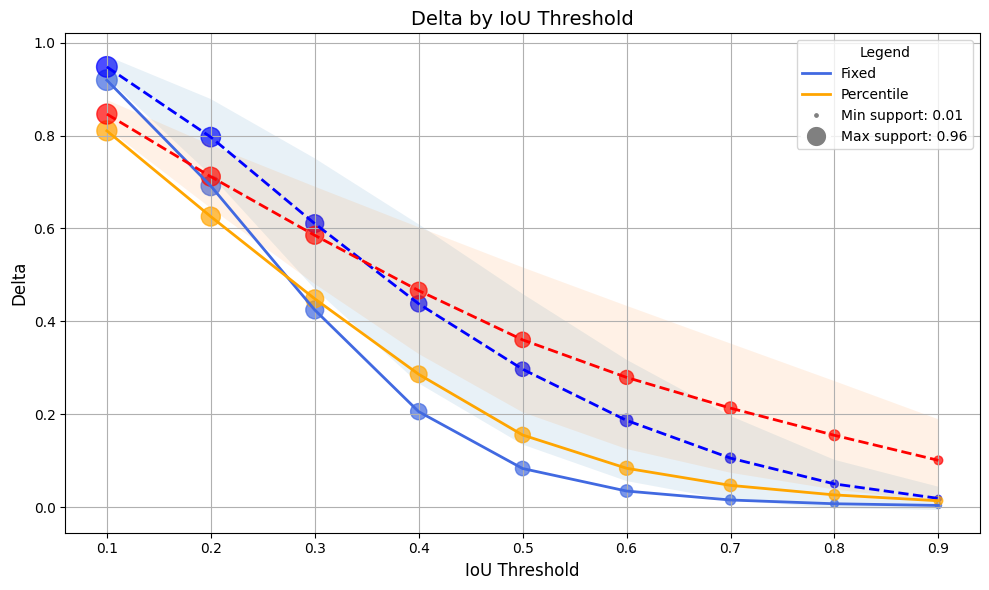

In [17]:
# --- Your data prep ---
plot_df = results_df.groupby(group_cols).agg(
    delta_cs_med=("delta_cs", np.mean),
    base_cs_supp_med=("baseline_cs_support_token", np.mean),
    supp_content_style_med=("support_content_style", np.mean),
    iou_threshold=("iou_threshold", np.mean),
    iou_score = ("iou_score", np.mean),
    use_quantile=("use_quantile", np.mean),
    iou_baseline_mean = ("iou_baseline_cs_mean", np.mean),
    iou_baseline_std = ("iou_baseline_cs_std", np.mean)
).reset_index()

# --- Set up plot ---
fig, ax = plt.subplots(figsize=(10, 6))

colors = {0: "royalblue", 1: "orange"}
baseline_colors = {0: "blue", 1: "red"}
labels = {0: "Fixed", 1: "Percentile"}

# Normalize marker sizes
min_supp = plot_df["supp_content_style_med"].min()
max_supp = plot_df["supp_content_style_med"].max()
plot_df["marker_sizes"] = 200 * (plot_df["supp_content_style_med"] - min_supp) / (max_supp - min_supp + 1e-8) + 20

# --- Plot each quantile group ---
for quantile_val in plot_df["use_quantile"].unique():
    filtered = plot_df[plot_df["use_quantile"] == quantile_val]

    ax.plot(
        filtered["iou_threshold"],
        filtered["iou_score"],
        label=labels[quantile_val],
        color=colors[quantile_val],
        linewidth=2
    )
    ax.scatter(
        filtered["iou_threshold"],
        filtered["iou_score"],
        s=filtered["marker_sizes"],
        color=colors[quantile_val],
        alpha=0.7
    )
    
    ax.plot(
        filtered["iou_threshold"],
        filtered["iou_baseline_mean"],
        label=labels[quantile_val],
        color=baseline_colors[quantile_val],
        linewidth=2,
        linestyle = "dashed"
    )
    ax.scatter(
        filtered["iou_threshold"],
        filtered["iou_baseline_mean"],
        s=filtered["marker_sizes"],
        color=baseline_colors[quantile_val],
        alpha=0.7
    )
    ci = 1.96 * filtered["iou_baseline_std"] / np.sqrt(len(filtered["iou_threshold"]))
    ax.fill_between(filtered["iou_threshold"], (filtered["iou_baseline_mean"] - ci),  (filtered["iou_baseline_mean"] + ci), alpha = 0.1)

# --- Create custom legend entries for marker sizes ---
legend_elements = [
    Line2D([0], [0], color='royalblue', lw=2, label='Fixed'),
    Line2D([0], [0], color='orange', lw=2, label='Percentile'),
    Line2D([0], [0], marker='o', color='w', label=f'Min support: {round(min_supp,2)}',
           markerfacecolor='gray', markersize=np.sqrt(plot_df["marker_sizes"].min())),
    Line2D([0], [0], marker='o', color='w', label=f'Max support: {round(max_supp,2)}',
           markerfacecolor='gray', markersize=np.sqrt(plot_df["marker_sizes"].max())),
]

ax.legend(handles=legend_elements, title="Legend")

# --- Axis labels and title ---
ax.set_title("Delta by IoU Threshold", fontsize=14)
ax.set_xlabel("IoU Threshold", fontsize=12)
ax.set_ylabel("Delta", fontsize=12)
ax.grid(True)

plt.tight_layout()
plt.show()

In [18]:
results_df.columns

Index(['prompt', 'template', 'content_word', 'style_word', 'seed',
       'use_quantile', 'iou_threshold', 'iou_baseline_mean',
       'iou_baseline_std', 'support_a_baseline', 'support_b_baseline',
       'support_intersection_baseline', 'support_union_baseline',
       'iou_baseline_cs_mean', 'iou_baseline_cs_std', 'support_a_baseline_cs',
       'support_b_baseline_cs', 'support_intersection_baseline_cs',
       'support_union_baseline_cs', 'iou_score', 'support_content',
       'support_style', 'support_intersection', 'support_union',
       'liz_content_category', 'Contemporary Realism', 'Rococo',
       'Impressionism', 'Synthetic Cubism', 'Realism', 'Color Field Painting',
       'Expressionism', 'Analytical Cubism', 'Baroque', 'Pointillism',
       'Naive Art Primitivism', 'High Renaissance', 'New Realism',
       'Art Nouveau', 'Romanticism', 'Early Renaissance', 'Symbolism',
       'Ukiyo e', 'Surrealism', 'Action painting', 'Northern Renaissance',
       'Minimalism', 'Manne

/tmp/ipykernel_1575296/1103656097.py:2: FutureWarning:

The provided callable <function mean at 0x7c798179f520> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

/tmp/ipykernel_1575296/1103656097.py:2: FutureWarning:

The provided callable <function mean at 0x7c798179f520> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.



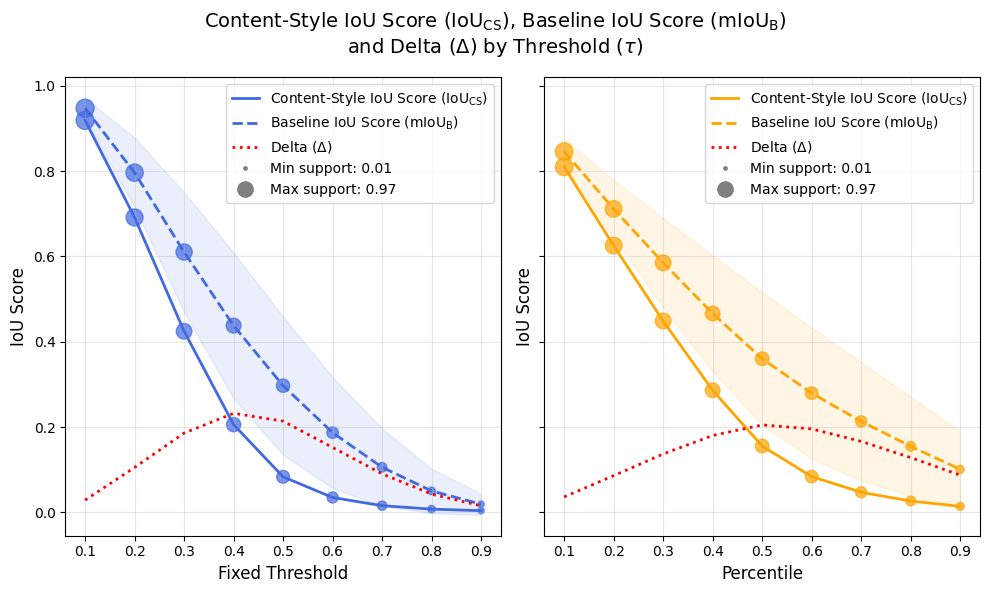

In [ ]:
# --- Your data prep ---
plot_df = results_df.groupby(group_cols).agg(
    delta_cs_med=("delta_cs", np.mean),
    base_cs_supp_med=("baseline_cs_support_token", np.mean),
    supp_content_style_med=("support_content_style", np.mean),
    iou_threshold=("iou_threshold", np.mean),
    iou_score = ("iou_score", np.mean),
    use_quantile=("use_quantile", np.mean),
    iou_baseline_mean = ("iou_baseline_cs_mean", np.mean),
    iou_baseline_std = ("iou_baseline_cs_std", np.mean)
).reset_index()

# --- Set up plot ---
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 6), sharex=True, sharey=True)

colors = {0: "royalblue", 1: "orange"}
labels = {0: "Fixed", 1: "Percentile"}

# Normalize marker sizes
min_supp = min(plot_df["supp_content_style_med"].min(), plot_df["base_cs_supp_med"].min())
max_supp = max(plot_df["supp_content_style_med"].max(), plot_df["base_cs_supp_med"].max())

plot_df["iou_marker_sizes"] = 150 * (plot_df["supp_content_style_med"] - min_supp) / (max_supp - min_supp + 1e-8) + 20
plot_df["baseline_marker_sizes"] = 150 * (plot_df["base_cs_supp_med"] - min_supp) / (max_supp - min_supp + 1e-8) + 20

legend_marker_min = min(plot_df["iou_marker_sizes"].min(), plot_df["baseline_marker_sizes"].min())
legend_marker_max = max(plot_df["iou_marker_sizes"].max(), plot_df["baseline_marker_sizes"].max())

# --- Plot each quantile group ---
for quantile_val in plot_df["use_quantile"].unique():
    filtered = plot_df[plot_df["use_quantile"] == quantile_val]

    ax = axes[int(quantile_val)]

    ax.plot(
        filtered["iou_threshold"],
        filtered["iou_score"],
        label=labels[quantile_val],
        color=colors[quantile_val],
        linewidth=2
    )
    ax.scatter(
        filtered["iou_threshold"],
        filtered["iou_score"],
        s=filtered["iou_marker_sizes"],
        color=colors[quantile_val],
        alpha=0.7
    )
    
    ax.plot(
        filtered["iou_threshold"],
        filtered["iou_baseline_mean"],
        label=labels[quantile_val],
        color=colors[quantile_val],
        linewidth=2,
        linestyle = "dashed"
    )
    ax.scatter(
        filtered["iou_threshold"],
        filtered["iou_baseline_mean"],
        s=filtered["baseline_marker_sizes"],
        color=colors[quantile_val],
        alpha=0.7
    )
    ci = 1.96 * filtered["iou_baseline_std"] / np.sqrt(len(filtered["iou_threshold"]))
    ax.fill_between(filtered["iou_threshold"], (filtered["iou_baseline_mean"] - ci),  (filtered["iou_baseline_mean"] + ci), alpha = 0.1, color = colors[quantile_val])
    
    ax.plot(
        filtered["iou_threshold"],
        filtered["delta_cs_med"],
        label=labels[quantile_val],
        color="red",
        linestyle="dotted",
        linewidth=2
    )

    # --- Create custom legend entries for marker sizes ---
    legend_elements = [
        # Line2D([0], [0], color='royalblue', lw=2, label='Fixed'),
        # Line2D([0], [0], color='orange', lw=2, label='Percentile'),
        Line2D([0], [0], color=colors[quantile_val], lw=2, label="Content-Style IoU Score ($\\text{IoU}_{\\text{CS}}$)"),
        Line2D([0], [0], color=colors[quantile_val], lw=2, label="Baseline IoU Score ($\\text{mIoU}_{\\text{B}}$)", linestyle="dashed"),
        Line2D([0], [0], color="red", lw=2, label="Delta ($\Delta$)", linestyle="dotted"),
        Line2D([0], [0], marker='o', color='w', label=f'Min support: {round(min_supp,2)}',
            markerfacecolor='gray', markersize=np.sqrt(legend_marker_min)),
        Line2D([0], [0], marker='o', color='w', label=f'Max support: {round(max_supp,2)}',
            markerfacecolor='gray', markersize=np.sqrt(legend_marker_max)),
    ]

    # ax.legend(handles=legend_elements, title=labels[quantile_val] + " Threshold")
    ax.legend(handles=legend_elements)

    # --- Axis labels and title ---
    # ax.set_title("Delta by IoU Threshold", fontsize=14)
    ax.grid(True, alpha=0.3)
    ax.set_xlabel(f"{'Percentile' if quantile_val else 'Fixed Threshold'}", fontsize=12)
    ax.set_ylabel("IoU Score", fontsize=12)
    ax.tick_params(labelbottom=True)

# fig.supylabel("IoU Score", fontsize=12)
fig.suptitle("Content-Style IoU Score ($\\text{IoU}_{\\text{CS}}$), Baseline IoU Score ($\\text{mIoU}_{\\text{B}}$) and Delta ($\Delta$) by Threshold ($\\tau$)", fontsize=14)
plt.tight_layout()

plt.savefig("./figures/scores_by_thresholds.pdf", bbox_inches='tight')

plt.show()

Overall, delta values are positive, and this suggests that this model is considering the concepts of style and content as distinct, complementary qualities affecting the resulting image. Using a relative threshold computing quantiles lead to a higher support overall wrt considering fixed thresholds (this is true especiallu for higher fixed tresholds). 

Greater delta values are encountered in threshold values from 0.4 to 0.7. This is quite strange since we expect that the higher the threshold, the fewer the pixels involved in the IoU computations, thus the lower the probability of having overlapping regions. 

We choose 0.5 (percentile) and 0.4 (fixed) as good trade offs offering enough support to sustain our results and higher delta values.

In [20]:
filtered_results = results_df.loc[#((results_df["iou_threshold"] == 0.5) & (results_df["use_quantile"] == True)) | 
                                  ((results_df["iou_threshold"] == 0.4) & (results_df["use_quantile"] == False))].copy()

## Median delta values considering prompt template and threshold configuration

In [21]:
filtered_results.groupby(["template"]).agg(
    delta_cs_med = ("delta_cs", np.median),
    delta_cs_iqr = ("delta_cs", lambda x : np.percentile(x, 0.75) - np.percentile(x, 0.25)),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
).round(3)

/tmp/ipykernel_1581673/51585615.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/51585615.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_cs_med,delta_cs_iqr,base_cs_supp_med
template,,,
a <CONTENT> in the <STYLE> style,0.295,0.144,0.619
a <CONTENT> with <STYLE> style,0.232,0.097,0.627
a <STYLE> painting of a <CONTENT>,0.261,0.105,0.621
a painting of a <CONTENT> in the <STYLE> style,0.300,0.085,0.612


In [22]:
fig = go.Figure()

fig.add_trace(
    go.Box(
        y=results_df["delta_cs"],
        x=results_df["template"],
        boxmean=True
    )
)

fig.update_layout(
    title="Delta by Template (F 0.4)",
    xaxis_title="Template",
    yaxis_title="Delta",
)

fig.show()

There is no visible difference across prompts. 

The prompt reaching the maximum delta is "a painting of a \<CONTENT\> in the \<STYLE\> style".

The prompt reaching the minimum delta is "a \<CONTENT\> with \<STYLE\> style".

## Median delta values for each style

In [23]:
# Step 3: Group by the style name
medians = filtered_results.groupby(["style_word"])["delta_cs"].median().reset_index()
filtered_results["median_per_style"] = filtered_results.apply(lambda row: medians[medians["style_word"] == row["style_word"]]["delta_cs"].iloc[0].item(), axis = 1)
f_filtered = filtered_results.sort_values(by = "median_per_style", ascending = False)

fig = go.Figure()

fig.add_trace(
    go.Box(
        y=f_filtered["delta_cs"],
        x=f_filtered["style_word"],
        boxmean=True
    )
)

fig.update_layout(
    title="Delta by Style (F 0.4)",
    xaxis_title="Style",
    yaxis_title="Delta",
)

fig.show()

The model is not behaving the same across styles. There are styles (Art Nouveau, Analytical Cubism) for which the distinction between the content heatmap and the style heatmap is much noticeable than others (Expressionism, Baroque).

In [24]:
filtered_results.groupby(["style_word"]).agg(
    delta_cs_med = ("delta_cs", np.median),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
).sort_values(by = "delta_cs_med").round(3).head(10)

/tmp/ipykernel_1581673/813264155.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/813264155.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_cs_med,base_cs_supp_med
style_word,,
Rembrandt,-0.073,0.624
Baroque,0.076,0.639
Expressionism,0.104,0.627
Raphael Kirchner,0.105,0.599
Cubism,0.134,0.637
Vincent van Gogh,0.140,0.604
Abstract Expressionism,0.148,0.572
Paul Cezanne,0.157,0.591
Camille Pissarro,0.159,0.610


In [25]:
filtered_results.groupby(["style_word"]).agg(
    delta_cs_med = ("delta_cs", np.median),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
).sort_values(by = "delta_cs_med").round(3).tail(10)

/tmp/ipykernel_1581673/1298796581.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/1298796581.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_cs_med,base_cs_supp_med
style_word,,
John Singer Sargent,0.354,0.621
Mannerism Late Renaissance,0.355,0.615
High Renaissance,0.358,0.627
Contemporary Realism,0.358,0.656
Art Nouveau,0.361,0.625
Albrecht Durer,0.369,0.583
Ukiyo e,0.371,0.631
Minimalism,0.376,0.647
Rococo,0.411,0.643


## Median delta values for each content category

In [26]:
filtered_results.groupby(["liz_content_category"]).agg(
    delta_cs_med = ("delta_cs", np.median),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
).sort_values(by = "delta_cs_med").round(3)

/tmp/ipykernel_1581673/4025849862.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/4025849862.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_cs_med,base_cs_supp_med
liz_content_category,,
person,0.010,0.661
road items,0.172,0.740
furniture,0.194,0.620
non modern vehicle,0.223,0.615
wearables,0.228,0.610
electronics,0.249,0.628
kitchen utensils,0.253,0.618
modern vehicle,0.256,0.595
meals,0.260,0.619


In [27]:
filtered_results.groupby(["content_word"]).agg(
    delta_cs_med = ("delta_cs", np.median),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
).sort_values(by = "delta_cs_med").round(3).head(10)

/tmp/ipykernel_1581673/2715980022.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/2715980022.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_cs_med,base_cs_supp_med
content_word,,
person,0.010,0.661
hot dog,0.037,0.765
tie,0.052,0.636
bed,0.068,0.654
fire hydrant,0.126,0.741
vase,0.130,0.604
cell phone,0.144,0.678
dining table,0.145,0.588
umbrella,0.146,0.619


In [28]:
filtered_results.groupby(["content_word"]).agg(
    delta_cs_med = ("delta_cs", np.median),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
).sort_values(by = "delta_cs_med").round(3).tail(10)

/tmp/ipykernel_1581673/2353560465.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1581673/2353560465.py:1: FutureWarning:

The provided callable <function median at 0x775bb6df72e0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_cs_med,base_cs_supp_med
content_word,,
broccoli,0.375,0.556
cow,0.376,0.594
zebra,0.376,0.618
sandwich,0.383,0.596
bear,0.395,0.621
mouse,0.398,0.637
tennis racket,0.399,0.624
sheep,0.403,0.640
banana,0.420,0.640


In [29]:
# Step 3: Group by the style name
medians = filtered_results.groupby(["liz_content_category"])["delta_cs"].median().reset_index()
filtered_results["median_per_style"] = filtered_results.apply(lambda row: medians[medians["liz_content_category"] == row["liz_content_category"]]["delta_cs"].iloc[0].item(), axis = 1)
f_filtered = filtered_results.sort_values(by = "median_per_style", ascending = False)

fig = go.Figure()

fig.add_trace(
    go.Box(
        y=f_filtered["delta_cs"],
        x=f_filtered["liz_content_category"],
        boxmean=True
    )
)

fig.update_layout(
    title="Delta by Content (F 0.4)",
    xaxis_title="Content",
    yaxis_title="Delta",
)

fig.show()

The model is still not behaving the same depending on the depicted content. Accessories and vehicles seems to have a higher distinction between content and styles than people.

## Heatmaps of delta values for contents and styles

In [30]:
# Ensure consistent sorting
filtered_results_sorted = filtered_results.sort_values(by=["liz_content_category", "style_word"], ascending=False)

# Create pivot table with median values
pivot_table = filtered_results_sorted.pivot_table(
    index="liz_content_category", 
    columns="style_word", 
    values="delta_cs", 
    aggfunc="median"
)

# Preserve the order of rows and columns as in the sorted DataFrame
y_labels = filtered_results_sorted["liz_content_category"].drop_duplicates().tolist()
x_labels = filtered_results_sorted["style_word"].drop_duplicates().tolist()

# Reindex to enforce the same order
pivot_table = pivot_table.reindex(index=y_labels, columns=x_labels)

# Create heatmap
fig = go.Figure(data=go.Heatmap(
    z=pivot_table.values,
    x=pivot_table.columns,
    y=pivot_table.index
))

fig.update_layout(
    height=600,
    width=1200
)
fig.show()

In [31]:
# Ensure consistent sorting
filtered_results_sorted = filtered_results.sort_values(by=["content_category", "style_word"], ascending=False)

# Create pivot table with median values
pivot_table = filtered_results_sorted.pivot_table(
    index="content_category", 
    columns="style_word", 
    values="delta_cs", 
    aggfunc="median"
)

# Preserve the order of rows and columns as in the sorted DataFrame
y_labels = filtered_results_sorted["content_category"].drop_duplicates().tolist()
x_labels = filtered_results_sorted["style_word"].drop_duplicates().tolist()

# Reindex to enforce the same order
pivot_table = pivot_table.reindex(index=y_labels, columns=x_labels)

# Create heatmap
fig = go.Figure(data=go.Heatmap(
    z=pivot_table.values,
    x=pivot_table.columns,
    y=pivot_table.index
))

fig.update_layout(
    height=600,
    width=1200
)
fig.show()

In [32]:
# Ensure consistent sorting
filtered_results_sorted = filtered_results.sort_values(by=["content_word", "style_word"], ascending=False)

# Create pivot table with median values
pivot_table = filtered_results_sorted.pivot_table(
    index="content_word", 
    columns="style_word", 
    values="delta_cs", 
    aggfunc="median"
)

# Preserve the order of rows and columns as in the sorted DataFrame
y_labels = filtered_results_sorted["content_word"].drop_duplicates().tolist()
x_labels = filtered_results_sorted["style_word"].drop_duplicates().tolist()

# Reindex to enforce the same order
pivot_table = pivot_table.reindex(index=y_labels, columns=x_labels)

# Create heatmap
fig = go.Figure(data=go.Heatmap(
    z=pivot_table.values,
    x=pivot_table.columns,
    y=pivot_table.index
))

fig.update_layout(
    height=1800,
    width=1200
)
fig.show()

In [33]:
filtered_results = results_df.loc[((results_df["iou_threshold"] == 0.4) & (results_df["use_quantile"] == False))].copy()

# Ensure consistent sorting
filtered_results_artists = filtered_results[filtered_results["style_word"].isin(artists)].sort_values(by=["content_word", "style_word"], ascending=False)
filtered_results_movements = filtered_results[filtered_results["style_word"].isin(movements)].sort_values(by=["content_word", "style_word"], ascending=False)

# Create pivot table with median values
pivot_table_artists = filtered_results_artists.pivot_table(
    index="content_word", 
    columns="style_word", 
    values="delta_cs", 
    aggfunc="median"
)

pivot_table_movements = filtered_results_movements.pivot_table(
    index="content_word", 
    columns="style_word", 
    values="delta_cs", 
    aggfunc="median"
)

# Preserve the order of rows and columns as in the sorted DataFrame
y_labels_artists = filtered_results_artists["content_word"].drop_duplicates().tolist()
x_labels_artists = filtered_results_artists["style_word"].drop_duplicates().tolist()

y_labels_movements = filtered_results_movements["content_word"].drop_duplicates().tolist()
x_labels_movements = filtered_results_movements["style_word"].drop_duplicates().tolist()

# Reindex to enforce the same order
pivot_table_artists = pivot_table_artists.reindex(index=y_labels_artists, columns=x_labels_artists)
pivot_table_movements = pivot_table_movements.reindex(index=y_labels_movements, columns=x_labels_movements)

fig = make_subplots(rows=1, cols=2, subplot_titles=("Artists", "Movements"), horizontal_spacing=0.1, shared_yaxes=True)

fig.add_trace(
    go.Heatmap(
        z=pivot_table_artists.values,
        x=pivot_table_artists.columns,
        y=pivot_table_artists.index,
        coloraxis = "coloraxis",
    ),
    row=1, col=1
)

fig.add_trace(
    go.Heatmap(
        z=pivot_table_movements.values,
        x=pivot_table_movements.columns,
        y=pivot_table_movements.index,
        coloraxis = "coloraxis"
    ),
    row=1, col=2
)
fig.update_layout(
    height=1500,
    width=1000,
    yaxis_title="Content",
    coloraxis = {'colorscale':'PiYG'},
    margin=dict(l=20, r=20, t=20, b=20),
    plot_bgcolor='rgba(0,0,0,0)'
)

fig.update_xaxes(tickmode='linear')
fig.update_yaxes(tickmode='linear')

fig.write_image("figures/content-style-heatmap.png", width=1000, height=1500, scale=4)

fig.show()

In [34]:
filtered_results = results_df.loc[((results_df["iou_threshold"] == 0.4) & (results_df["use_quantile"] == False))].copy()

# Ensure consistent sorting
filtered_results_artists = filtered_results[filtered_results["style_word"].isin(artists)].sort_values(by=["content_word", "style_word"], ascending=False)
filtered_results_movements = filtered_results[filtered_results["style_word"].isin(movements)].sort_values(by=["content_word", "style_word"], ascending=False)

# Create pivot table with median values
pivot_table_artists = filtered_results_artists.pivot_table(
    index="style_word", 
    columns="content_word", 
    values="delta_cs", 
    aggfunc="median"
)

pivot_table_movements = filtered_results_movements.pivot_table(
    index="style_word", 
    columns="content_word", 
    values="delta_cs", 
    aggfunc="median"
)

# Preserve the order of rows and columns as in the sorted DataFrame
y_labels_artists = filtered_results_artists["style_word"].drop_duplicates().tolist()
x_labels_artists = filtered_results_artists["content_word"].drop_duplicates().tolist()

y_labels_movements = filtered_results_movements["style_word"].drop_duplicates().tolist()
x_labels_movements = filtered_results_movements["content_word"].drop_duplicates().tolist()

# Reindex to enforce the same order
pivot_table_artists = pivot_table_artists.reindex(index=y_labels_artists, columns=x_labels_artists)
pivot_table_movements = pivot_table_movements.reindex(index=y_labels_movements, columns=x_labels_movements)

fig = make_subplots(rows=2, cols=1, subplot_titles=("Artists", "Movements"), vertical_spacing=0.15, shared_xaxes=True)

fig.add_trace(
    go.Heatmap(
        z=pivot_table_artists.values,
        x=pivot_table_artists.columns,
        y=pivot_table_artists.index,
        coloraxis = "coloraxis",
    ),
    row=1, col=1
)

fig.add_trace(
    go.Heatmap(
        z=pivot_table_movements.values,
        x=pivot_table_movements.columns,
        y=pivot_table_movements.index,
        coloraxis = "coloraxis"
    ),
    row=2, col=1
)

fig.update_layout(
    height=1000,
    width=1500,
    coloraxis = {'colorscale':'PiYG'},
    margin=dict(l=20, r=20, t=20, b=20),
    plot_bgcolor='rgba(0,0,0,0)'
)

fig.update_xaxes(tickmode='linear', showticklabels=True, row=1, col=1)
fig.update_xaxes(tickmode='linear', showticklabels=True, row=2, col=1)
fig.update_yaxes(tickmode='linear')

fig.write_image("figures/content-style-heatmap-h.png", width=1500, height=1000, scale=4)

fig.show()

In [35]:
pivot_table_artists.T.describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = False).round(2)

,mean,std
style_word,,
Albrecht Durer,0.35,0.10
John Singer Sargent,0.33,0.10
Salvador Dali,0.29,0.09
Pyotr Konchalovsky,0.29,0.11
Claude Monet,0.27,0.11
Eugene Boudin,0.27,0.11
Ivan Shishkin,0.27,0.12
Ilya Repin,0.25,0.12
Edgar Degas,0.24,0.14


In [36]:
pivot_table_movements.T.describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = False).round(2)

,mean,std
style_word,,
New Realism,0.39,0.08
Rococo,0.38,0.09
Minimalism,0.35,0.09
Ukiyo e,0.35,0.08
Art Nouveau,0.34,0.09
Realism,0.34,0.09
Mannerism Late Renaissance,0.34,0.08
High Renaissance,0.33,0.10
Contemporary Realism,0.32,0.12


In [37]:
pd.concat([pivot_table_artists, pivot_table_movements]).describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = False).round(2).head(10)

,mean,std
content_word,,
giraffe,0.43,0.08
banana,0.39,0.09
sheep,0.37,0.12
bear,0.37,0.11
zebra,0.35,0.12
mouse,0.35,0.13
sandwich,0.35,0.10
tennis racket,0.35,0.13
carrot,0.34,0.13


In [38]:
pd.concat([pivot_table_artists, pivot_table_movements]).describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = False).round(2).tail(10)

,mean,std
content_word,,
remote,0.15,0.12
fire hydrant,0.14,0.10
dining table,0.13,0.08
umbrella,0.11,0.19
vase,0.11,0.21
cell phone,0.10,0.17
tie,0.06,0.17
hot dog,0.04,0.08
bed,0.04,0.15


In [63]:
top_artists = pivot_table_artists.T.describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = False).reset_index()["style_word"].head(5).round(2).values
top_movements = pivot_table_movements.T.describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = False).reset_index()["style_word"].head(5).round(2).values
top_contents = pd.concat([pivot_table_artists, pivot_table_movements]).describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = False).reset_index()["content_word"].round(2).head(5).values

filtered_results[
    (filtered_results["content_word"].isin(top_contents)) &
    (
        filtered_results["style_word"].isin(top_movements) |
        filtered_results["style_word"].isin(top_artists)
    )
].sort_values(by = "delta_cs")[["prompt", "delta_cs", "seed"]].tail(5)

,prompt,delta_cs,seed
90960,a Art Nouveau painting of a bear,0.477746,5053
42090,a painting of a banana in the John Singer Sarg...,0.479387,2338
16602,a painting of a sheep in the Rococo style,0.481571,922
113964,a Claude Monet painting of a banana,0.481821,6331
21102,a painting of a giraffe in the Rococo style,0.483490,1172


In [67]:
bottom_artists = pivot_table_artists.T.describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = True).reset_index()["style_word"].head(5).round(2).values
bottom_movements = pivot_table_movements.T.describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = True).reset_index()["style_word"].head(5).round(2).values
bottom_contents = pd.concat([pivot_table_artists, pivot_table_movements]).describe().loc[["mean", "std"]].T.sort_values(by = "mean", ascending = True).reset_index()["content_word"].round(2).head(5).values

filtered_results[
    (filtered_results["content_word"].isin(bottom_contents)) &
    (
        filtered_results["style_word"].isin(bottom_movements) |
        filtered_results["style_word"].isin(bottom_artists)
    )
].sort_values(by = "delta_cs")[["prompt", "delta_cs", "seed"]].head(50)

,prompt,delta_cs,seed
168306,a tie in the Abstract Expressionism style,-0.687792,9350
125106,a Abstract Expressionism painting of a bed,-0.536914,6950
168,a painting of a person in the Expressionism style,-0.525151,9
169188,a tie in the Vincent van Gogh style,-0.514769,9399
240522,a tie with Impressionism style,-0.505988,13362
276306,a cell phone with Abstract Expressionism style,-0.504424,15350
53232,a painting of a bed in the Cubism style,-0.496424,2957
125934,a Raphael Kirchner painting of a bed,-0.488053,6996
72222,a Impressionism painting of a person,-0.485567,4012
96306,a Abstract Expressionism painting of a tie,-0.479327,5350


## Median delta values for each style-content category pair

In [39]:
# Step 3: Group by the style name
filtered_results.groupby(["threshold","style_word", "content_word"]).agg(
    delta_cs_avg=("delta_cs", np.mean),
    delta_cs_std=("delta_cs", np.std),
).round(2).sort_values("delta_cs_avg").head(10)

/tmp/ipykernel_1581673/640696188.py:2: FutureWarning:

The provided callable <function mean at 0x775bd01d2d40> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

/tmp/ipykernel_1581673/640696188.py:2: FutureWarning:

The provided callable <function std at 0x775bd01d2e60> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



delta_cs_avg  delta_cs_std
threshold style_word             content_word                            
F 0.4     Abstract Expressionism tie                  -0.44          0.20
          Rembrandt              teddy bear           -0.44          0.05
                                 vase                 -0.43          0.19
                                 dog                  -0.42          0.06
                                 bird                 -0.42          0.30
                                 zebra                -0.38          0.22
          Impressionism          vase                 -0.38          0.11
          Rembrandt              cow                  -0.34          0.09
          Vincent van Gogh       bed                  -0.34          0.10
          Raphael Kirchner       vase                 -0.33          0.11

In [40]:
filtered_results.groupby(["threshold","style_word", "content_word"]).agg(
    delta_cs_avg=("delta_cs", np.mean),
    delta_cs_std=("delta_cs", np.std),
).round(2).sort_values("delta_cs_avg").tail(15)

/tmp/ipykernel_1581673/1106142255.py:1: FutureWarning:

The provided callable <function mean at 0x775bd01d2d40> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

/tmp/ipykernel_1581673/1106142255.py:1: FutureWarning:

The provided callable <function std at 0x775bd01d2e60> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



delta_cs_avg  delta_cs_std
threshold style_word                 content_word                             
F 0.4     Rococo                     knife                  0.46          0.02
          New Realism                tennis racket          0.46          0.02
          Rococo                     apple                  0.47          0.01
          New Realism                broccoli               0.47          0.01
                                     banana                 0.47          0.00
          High Renaissance           donut                  0.47          0.02
          Analytical Cubism          giraffe                0.47          0.01
          Pointillism                giraffe                0.47          0.01
          Mannerism Late Renaissance broccoli               0.47          0.03
          Realism                    giraffe                0.47          0.01
          Action painting            giraffe                0.47          0.01
          Post Impressionism         giraffe                0.47          0.01
          Rococo                     giraffe                0.47          0.01
                                     sheep                  0.47          0.01
                                     teddy bear             0.48          0.00

Reiterating previous comments, the "person" content is the one for which ``iou_score`` is lower than the baseline. 

## Experiments with highest and lowest delta values : examples for previous analysis

In [36]:
# Highest values of delta 
filtered_results.sort_values(by="delta", ascending=False)[["prompt", "template","content_word", "style_word", "threshold", "iou_score", "iou_baseline_mean", "iou_baseline_cs_mean", "delta", "delta_cs", "baseline_cs_support_token", "baseline_support_token", "support_content_style"]].head(10)

,prompt,template,content_word,style_word,threshold,iou_score,iou_baseline_mean,iou_baseline_cs_mean,delta,delta_cs,baseline_cs_support_token,baseline_support_token,support_content_style
9924,a painting of a stop sign in the Action painti...,a painting of a <CONTENT> in the <STYLE> style,stop sign,Action painting,F 0.4,0.001231,0.757130,0.492329,0.755899,0.491098,0.696191,0.814200,0.499509
34458,a painting of a tennis racket in the Minimalis...,a painting of a <CONTENT> in the <STYLE> style,tennis racket,Minimalism,F 0.4,0.000086,0.739538,0.484872,0.739453,0.484786,0.664920,0.769916,0.489926
10158,a painting of a stop sign in the Minimalism style,a painting of a <CONTENT> in the <STYLE> style,stop sign,Minimalism,F 0.4,0.025632,0.758642,0.497374,0.733011,0.471743,0.698247,0.812560,0.507726
49290,a painting of a donut in the John Singer Sarge...,a painting of a <CONTENT> in the <STYLE> style,donut,John Singer Sargent,F 0.4,0.000000,0.732340,0.475617,0.732340,0.475617,0.679442,0.793821,0.488811
43674,a painting of a sandwich in the Ukiyo e style,a painting of a <CONTENT> in the <STYLE> style,sandwich,Ukiyo e,F 0.4,0.002472,0.728653,0.472112,0.726181,0.469640,0.686466,0.804856,0.489150
30858,a painting of a baseball bat in the Minimalism...,a painting of a <CONTENT> in the <STYLE> style,baseball bat,Minimalism,F 0.4,0.003508,0.727983,0.456572,0.724475,0.453064,0.691271,0.823394,0.471066
41712,a painting of a banana in the Northern Renaiss...,a painting of a <CONTENT> in the <STYLE> style,banana,Northern Renaissance,F 0.4,0.013704,0.735388,0.489736,0.721684,0.476032,0.702966,0.820638,0.506845
21102,a painting of a giraffe in the Rococo style,a painting of a <CONTENT> in the <STYLE> style,giraffe,Rococo,F 0.4,0.008885,0.724621,0.492375,0.715735,0.483490,0.677310,0.781116,0.504300
31902,a painting of a baseball glove in the Rococo s...,a painting of a <CONTENT> in the <STYLE> style,baseball glove,Rococo,F 0.4,0.000000,0.711350,0.475927,0.711350,0.475927,0.624443,0.716851,0.470429
20742,a painting of a giraffe in the Analytical Cubi...,a painting of a <CONTENT> in the <STYLE> style,giraffe,Analytical Cubism,F 0.4,0.002833,0.713576,0.479454,0.710743,0.476621,0.690225,0.810463,0.489828


In [37]:
# Lowest values of delta 
filtered_results[(~ filtered_results["delta"].isna())].sort_values(by="delta", ascending=False)[["prompt", "template", "content_word", "style_word", "threshold", "iou_score", "iou_baseline_mean", "iou_baseline_cs_mean", "delta", "delta_cs", "baseline_cs_support_token", "baseline_support_token", "support_content_style"]].tail(10)

,prompt,template,content_word,style_word,threshold,iou_score,iou_baseline_mean,iou_baseline_cs_mean,delta,delta_cs,baseline_cs_support_token,baseline_support_token,support_content_style
283920,a vase with Romanticism style,a <CONTENT> with <STYLE> style,vase,Romanticism,F 0.4,0.963854,0.420176,0.436915,-0.543678,-0.526939,0.705262,0.651003,0.868040
240864,a tie with Claude Monet style,a <CONTENT> with <STYLE> style,tie,Claude Monet,F 0.4,0.898453,0.345861,0.388610,-0.552592,-0.509843,0.659157,0.566662,0.936642
168,a painting of a person in the Expressionism style,a painting of a <CONTENT> in the <STYLE> style,person,Expressionism,F 0.4,0.839966,0.266171,0.314815,-0.573794,-0.525151,0.621306,0.469061,0.875049
154032,a stop sign in the Cubism style,a <CONTENT> in the <STYLE> style,stop sign,Cubism,F 0.4,0.921273,0.333957,0.209068,-0.587316,-0.712205,0.599456,0.465859,0.911182
240522,a tie with Impressionism style,a <CONTENT> with <STYLE> style,tie,Impressionism,F 0.4,0.947126,0.355973,0.441139,-0.591153,-0.505988,0.711493,0.625009,0.970945
153906,a stop sign in the Abstract Expressionism style,a <CONTENT> in the <STYLE> style,stop sign,Abstract Expressionism,F 0.4,0.821543,0.228775,0.258306,-0.592768,-0.563237,0.579128,0.441219,0.900915
276306,a cell phone with Abstract Expressionism style,a <CONTENT> with <STYLE> style,cell phone,Abstract Expressionism,F 0.4,0.850234,0.248711,0.345810,-0.601523,-0.504424,0.647928,0.556017,0.923661
222288,a train with Vincent van Gogh style,a <CONTENT> with <STYLE> style,train,Vincent van Gogh,F 0.4,0.951284,0.313157,0.389084,-0.638127,-0.562201,0.689298,0.595292,0.971318
222180,a train with Paul Cezanne style,a <CONTENT> with <STYLE> style,train,Paul Cezanne,F 0.4,0.960193,0.305505,0.345196,-0.654688,-0.614997,0.663312,0.567845,0.949714
168306,a tie in the Abstract Expressionism style,a <CONTENT> in the <STYLE> style,tie,Abstract Expressionism,F 0.4,0.955532,0.236214,0.267740,-0.719318,-0.687792,0.627936,0.479457,0.974386


There is a particular 

## Highest delta values for content word and style word

In [38]:
filtered_results.groupby(["content_word", "style_word"])[["delta","delta_cs", "iou_score"]].median().sort_values(by="delta", ascending=False).head(10)

delta  delta_cs  iou_score
content_word  style_word                                      
carrot        Rococo             0.657917  0.467360   0.023900
toothbrush    Pop Art            0.655636  0.447555   0.024964
wine glass    Albrecht Durer     0.649248  0.461172   0.020712
baseball bat  New Realism        0.646343  0.448305   0.002076
tennis racket Minimalism         0.642326  0.452738   0.005748
              Albrecht Durer     0.640687  0.458684   0.015593
donut         High Renaissance   0.639595  0.472290   0.013874
fork          Minimalism         0.639570  0.459724   0.019113
giraffe       Analytical Cubism  0.633041  0.473807   0.005349
broccoli      Synthetic Cubism   0.632878  0.456962   0.028104

In [39]:
filtered_results.groupby(["content_word", "style_word"])[["delta","delta_cs", "iou_score"]].median().sort_values(by="delta", ascending=False).tail(10)

delta  delta_cs  iou_score
content_word style_word                                           
tie          Cubism                 -0.303774 -0.285967   0.655441
cell phone   Abstract Expressionism -0.304609 -0.273586   0.634102
bed          Impressionism          -0.306418 -0.254661   0.779544
frisbee      Abstract Expressionism -0.314472 -0.260876   0.664830
vase         Impressionism          -0.334115 -0.378688   0.794897
umbrella     Abstract Expressionism -0.344762 -0.272702   0.642467
bed          Vincent van Gogh       -0.363524 -0.332961   0.772609
             Childe Hassam          -0.380599 -0.324825   0.750816
train        Edgar Degas            -0.385355 -0.310499   0.776327
tie          Abstract Expressionism -0.460766 -0.417387   0.794881

As we said before, "person" is the content with higher overlap with "style". The most affected threshold configuration seems to be P 0.5.

## Tests for statistical significant difference between iou_score and iou_baseline_mean

Is iou_score significantly different from iou_baseline_mean on average across all prompts?

In [40]:
from scipy import stats

In [41]:
for config in results_df["threshold"].unique():
    subset = results_df[results_df["threshold"] == config]
    t_stat, p_value = stats.ttest_rel(subset['iou_baseline_cs_mean'], subset['iou_score'])
    print(f"Paired t-test for IoU vs CS Baseline ({config}): t_stat={t_stat:.3f}, p_value={p_value:.03f}")

Paired t-test for IoU vs CS Baseline (F 0.1): t_stat=79.336, p_value=0.000
Paired t-test for IoU vs CS Baseline (P 0.1): t_stat=120.706, p_value=0.000
Paired t-test for IoU vs CS Baseline (F 0.2): t_stat=115.283, p_value=0.000
Paired t-test for IoU vs CS Baseline (P 0.2): t_stat=141.507, p_value=0.000
Paired t-test for IoU vs CS Baseline (F 0.3): t_stat=141.779, p_value=0.000
Paired t-test for IoU vs CS Baseline (P 0.3): t_stat=150.086, p_value=0.000
Paired t-test for IoU vs CS Baseline (F 0.4): t_stat=158.981, p_value=0.000
Paired t-test for IoU vs CS Baseline (P 0.4): t_stat=149.886, p_value=0.000
Paired t-test for IoU vs CS Baseline (F 0.5): t_stat=160.893, p_value=0.000
Paired t-test for IoU vs CS Baseline (P 0.5): t_stat=146.408, p_value=0.000
Paired t-test for IoU vs CS Baseline (F 0.6): t_stat=142.494, p_value=0.000
Paired t-test for IoU vs CS Baseline (P 0.6): t_stat=147.051, p_value=0.000
Paired t-test for IoU vs CS Baseline (F 0.7): t_stat=114.475, p_value=0.000
Paired t-test

For both configurations and deltas, there is a statistical difference proving the strenght of our previous results.

In [42]:
# How many std away is the iou_score from the iou_baseline_mean?
results_df["z_score"] = (results_df["iou_baseline_mean"] - results_df["iou_score"]) / results_df["iou_baseline_std"]
results_df["z_score_cs"] = (results_df["iou_baseline_cs_mean"] - results_df["iou_score"]) / results_df["iou_baseline_std"]
results_df.groupby(group_cols).agg(
    delta_med = ("delta", np.median),
    delta_cs_med = ("delta_cs", np.median),
    base_supp_med = ("baseline_support_token", np.median),
    base_cs_supp_med = ("baseline_cs_support_token", np.median),
    supp_content_style_med = ("support_content_style", np.median),
    med_num_std = ("z_score", np.median),
    med_num_cs_std = ("z_score_cs", np.median),
).round(3)

/tmp/ipykernel_1578766/2217583141.py:4: FutureWarning:

The provided callable <function median at 0x734b1cdcd630> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

/tmp/ipykernel_1578766/2217583141.py:4: FutureWarning:

The provided callable <function median at 0x734b1cdcd630> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



,delta_med,delta_cs_med,base_supp_med,base_cs_supp_med,supp_content_style_med,med_num_std,med_num_cs_std
threshold,,,,,,,
F 0.1,0.022,0.015,0.982,0.979,0.974,1.286,0.900
F 0.2,0.124,0.090,0.906,0.888,0.861,1.377,1.006
F 0.3,0.267,0.201,0.791,0.753,0.691,1.407,1.069
F 0.4,0.342,0.273,0.651,0.619,0.541,1.378,1.095
F 0.5,0.289,0.241,0.493,0.472,0.438,1.167,0.996
F 0.6,0.193,0.159,0.330,0.320,0.299,0.914,0.787
F 0.7,0.117,0.086,0.179,0.176,0.159,0.723,0.588
F 0.8,0.062,0.035,0.065,0.064,0.055,0.572,0.402
F 0.9,0.025,0.006,0.009,0.010,0.009,0.412,0.190


Overall, ``iou_score`` are at ~ 1 standard deviation away (on the left side, given that it is smaller, and delta is positive) from ``iou_baseline_mean``and ``iou_baseline_cs_mean``.

In [47]:
results_df.groupby(group_cols).agg(
    med_num_cs_std = ("z_score_cs", np.median),
)["med_num_cs_std"].mean().round(2)

/tmp/ipykernel_1578766/240517544.py:1: FutureWarning:

The provided callable <function median at 0x734b1cdcd630> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



np.float64(0.83)

In [60]:
results_df[results_df["z_score_cs"] != -(np.inf)].groupby(group_cols).agg(
    med_num_cs_std = ("z_score_cs", np.median),
).mean().round(2)

/tmp/ipykernel_1578766/3312073099.py:1: FutureWarning:

The provided callable <function median at 0x734b1cdcd630> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.



med_num_cs_std    0.83
dtype: float64

In [ ]:
results_df[results_df["threshold"] == "F 0.8"]["z_score_cs"] ==

14        0.181130
32        0.150463
50        0.142346
68        0.621803
86       -0.019577
            ...   
287924    0.699444
287942    0.077560
287960    0.000000
287978    0.584924
287996    0.001153
Name: z_score_cs, Length: 16000, dtype: float64